# <center> Bike Sharing in Washington DC 

<m1><center> **Authors:** <br>
Frederik Hartmann, s174471 <br>
Jens Christian Bang Gribsvad, s174477 </center></m1>

# Content

1. Motivation
2. Basic Stats
    1. Preprocessing 
        1. Preprocessing of bikeshare data 
        2. Preprocessing of weather data 
    2. Data stats
3. Data analysis
    1. Temproal and Weather patterns
    2. Heat Maps
    3. Machine Learning prediction
4. Genre
    1. Visual Narrative tools
    2. Narrative Structure tools
5. Visualizations
6. Discussion
7. References

## 1. Motivation

What is your dataset?
Why did you choose this/these particular dataset(s)?
What was your goal for the end user's experience?

Our goal is to help more people to bike! In this project we will examine the patterns of bike sharing in Washington DC by investigating a dataset from the bike-sharing company *Captial Bikeshare* along with a dataset containing weather data. The data is recorded in a 2 year period from 2011 to 2012. We have chosen to work with these 2 datasets to enable an investigation of temporal patterns in weather data and number of rented bikes along with an analysis of geo data of the bike stations in the city. Moreover, will we use machine learning to create two models that can predict the number of rented bikes on unseen data.<br>
By investigating and learning about bike patterns we can, from the perspective of a bikesharing company, aim to make bike sharing more convienient for the customers. In particular, we must ensure there is always a sufficient supply of bikes to be rented and enough bike-stations around the city. 

## 2. Basic Stats 

Write about your choices in data cleaning and preprocessing
Write a short section that discusses the dataset stats, containing key points/plots from your exploratory data analysis.

As mentioned in *1. Motivation* we will investigate 2 datasets: <u> Weather data </u> and <u> Bikesharing data </u>. In the following an overview of the attributes in each dataset will be provided. <br>

**The weather dataset:** <br> 
The weather dataset contains hourly recordings across the following 17 features: 
- instant: record index
- dteday : date
- season : 1:winter, 2:spring, 3:summer, 4:fall
- yr : year (0: 2011, 1:2012)
- mnth : month ( 1 to 12)
- hr : hour (0 to 23)
- holiday : weather day is holiday or not (extracted from https://dchr.dc.gov/page/holiday-schedules)
- weekday : day of the week
- workingday : if day is neither weekend nor holiday is 1, otherwise is 0.
+ weathersit :
 - 1: Clear, Few clouds, Partly cloudy, Partly cloudy
 - 2: Mist + Cloudy, Mist + Broken clouds, Mist + Few clouds, Mist
 - 3: Light Snow, Light Rain + Thunderstorm + Scattered clouds, Light Rain + Scattered clouds
 - 4: Heavy Rain + Ice Pallets + Thunderstorm + Mist, Snow + Fog
- temp : Normalized temperature in Celsius. The values are derived via (t-t_min)/(t_max-t_min), t_min=-8, t_max=+39 (only in hourly scale)
- atemp: Normalized feeling temperature in Celsius. The values are derived via (t-t_min)/(t_max-t_min), t_min=-16, t_max=+50 (only in hourly scale)
- hum: Normalized humidity. The values are divided to 100 (max)
- windspeed: Normalized wind speed. The values are divided to 67 (max)
- casual: count of casual users
- registered: count of registered users
- cnt: count of total rental bikes including both casual and registered

**The bikesharing dataset:** <br>
Contains recordings for all bike rental trips made from 2011 to 2012 across the following 9 features:
- Duration (measured in seconds)
- Start date
- End date
- Start station number
- Start station (street address)
- End station number
- End station (street address)
- Bike number
- Member type (Member, Casual, Unknown)

### 2.1 Preprocessing

In [70]:
### Imports
import numpy as np
import pandas as pd 
from geopy.geocoders import Nominatim
import matplotlib.pyplot as plt
import folium
import datetime
from scipy import stats
import seaborn as sns
import os
from bokeh.plotting import figure, show
from bokeh.io import output_notebook, curdoc
from bokeh.models import Legend, ColumnDataSource, HoverTool, Arrow, OpenHead, NormalHead, VeeHead, Label, LabelSet, Range1d
from bokeh.models.widgets import Tabs, Panel
from bokeh.layouts import layout
from bokeh.palettes import Spectral6
from bokeh.plotting import figure, output_file , save
from bokeh.transform import factor_cmap
from sklearn.linear_model import Ridge
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split, RandomizedSearchCV,GridSearchCV
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import accuracy_score, precision_score, recall_score, confusion_matrix, ConfusionMatrixDisplay, mean_squared_error
import itertools

In [2]:
####################################################### Load data
# Weather data
df_weather = pd.read_csv('weatherData.csv')

# Bikesharing data
data2011 = pd.read_csv('2011-capitalbikeshare-tripdata.csv')
data2012q1 = pd.read_csv('2012Q1-capitalbikeshare-tripdata.csv')
data2012q2 = pd.read_csv('2012Q2-capitalbikeshare-tripdata.csv')
data2012q3 = pd.read_csv('2012Q3-capitalbikeshare-tripdata.csv')
data2012q4 = pd.read_csv('2012Q4-capitalbikeshare-tripdata.csv')
df_bike = pd.concat([data2011,data2012q1,data2012q2,data2012q3,data2012q4])

#### 2.1.1 Preprocessing of bikesharing data

**Choices:** <br>
- To obtain geo-data we needed to convert an address to longitude/latitude coordinates. We used the geocoder function *Nomatim*. However, we didn't succeed in converting all of the addresses in the data set so we left out the observations where we could not convert the address to longitude/latitude.
- Observations where the trip duration is less than 2 minutes were left out as we assume those observations are not a proper bike trip. Such observations could be customers struggling to rent a bike and accidentally start and stop a trip without going anywhere.

In [ ]:
# Remove duplicates
df_bike = df_bike.drop_duplicates()

################################### Converting addresses to longitude/latitude
# Create empty longitude/latitude columns
df_bike['longitude'] = 0
df_bike['latitude'] = 0
# Find all addresses of the bike stations
addies = df_bike.iloc[:,4].unique()
# Making an instance of Nominatim class
geolocator = Nominatim(user_agent="socialdataproj")
# Initialize counter of failed longitude/latitude conversion
fail_count = 0
# Loop across all distinct addresses
for i in range(len(addies)):
    # Address we need to geocode
    loc = addies[i]+' DC'     
    # Applying geocode method to get the location
    location = geolocator.geocode(loc)
    if location:
        # Save long lat
        idx = df_bike.iloc[:,4] == addies[i]
        df_bike.iloc[df_bike[idx].index,9] = location.longitude
        df_bike.iloc[df_bike[idx].index,10] = location.latitude
    else:
        # Count failed conversion
        fail_count += 1
# Drop rows with empty long/lat columns
df_bike = df_bike.drop(df_bike[df_bike.longitude == 0].index)


################################### Remove short trips
df_bike = df_bike[(df_bike.Duration > 120) & (df_bike['Start station number'] != df_bike['End station number'])]

################################### Create columns containing weekday, yearday and hourcycle
# Convert start time to datetime to weekday (weekdays numbered 0-6)
df_bike['weekday'] = pd.to_datetime(df_bike['Start date']).dt.weekday
# Convert start time to datetime to weekday (weekdays numbered 0-6)
df_bike['yearday'] = pd.to_datetime(df_bike['Start date']).dt.strftime('%j')
# Convert start time to datetime to weekday (weekdays numbered 0-6)
df_bike['hourcycle'] = pd.to_datetime(df_bike['Start date']).dt.strftime('%H')

#### 2.1.2 Prepocessing of weather data

**Choices:** <br>
- We perform basic cleaning by converting the date feature to datetime format, converting normalized temperature to normal temperature and removing duplicates.
- We remove the bike count recorded in the weather data and replace it with the hourly bike count from the bikesharing data after the data has been preprocessed.

In [3]:
################################### Basic cleaning
# Remove features 
df_weather.drop(['atemp','casual','registered','cnt'],axis=1)
# Convert to datetime format
df_weather['dteday'] = pd.to_datetime(df_weather['dteday'])
# Convert from normalized temperature to Celcius
df_weather['temp'] =  df_weather['temp']*(39 - (-8)) + (-8)
# Remove duplicates
df_weather = df_weather.drop_duplicates()

################################### Copy bike count from bikesharing data to weather data
# Select bikedata from each year
df_bike2011 = df_bike[df_bike.year == 2011]
df_bike2012 = df_bike[df_bike.year == 2012]

# Group data by yearday and hourcycle for the 2 years
cnt_bike2011 = df_bike2011.groupby(['yearday','hourcycle']).size().reset_index().rename(columns={0:'count'})
cnt_bike2012 = df_bike2012.groupby(['yearday','hourcycle']).size().reset_index().rename(columns={0:'count'})
# Combine the hourly bike count
cnt_comb = pd.concat([cnt_bike2011,cnt_bike2012]).reset_index()
cnt_comb = cnt_comb.drop(['index'],axis=1)

# Create empty count column
df_weather['cnt'] = 0
# Initialize year counter (0: 2011 , 1: 2012)
yr = 0
# Loop through all hourly bike rentals
for i in range(len(cnt_comb)):
    yrday = cnt_comb.iloc[i,0]
    hr = cnt_comb.iloc[i,1]
    # Find in weather data that matches bike data
    idx = df_weather.index[(df_weather.yearday == yrday) & (df_weather.hr == int(hr)) & (df_weather.yr == yr)].tolist()
    # Save count from bike data in weather data
    df_weather.iloc[idx,df_weather.shape[1]-1] = cnt_comb.iloc[i,2]
    if yrday == '365' and int(hr) == 23 and yr == 0:
        yr += 1

AttributeError: 'DataFrame' object has no attribute 'year'

### 2.2 Data stats

Lets get more familiar with the data set and explore some basic data stats. <br>

In [64]:
print('----- Data dimensions -----')
print('Bike data contains {} bike trips from 2011-2012. These recordings is measured across the {} aforementioned features. \n'.format(df_bike.shape[0],df_bike.shape[1]))
print('Weather data contains {} hourly recordings from 2011-2012. These recordings is measured across the {} aforementioned features.'.format(df_weather.shape[0],df_weather.shape[1]))

print('----- Features of interest -----')
print('There is {} distinct bike stations in Washington D.C. However, we only focus on {} stations.'.format(len(df_bike['Start station'].unique()) + fail_count,len(df_bike['Start station'].unique())))
print('The fraction of membership users are {:.2f} while the fraction of single trip users are {:.2f}'.format(df_weather.registered.sum()/df_weather.cnt.sum(),df_weather.casual.sum()/df_weather.cnt.sum()))

----- Data dimensions -----
Bike data contains 3255678 bike trips from 2011-2012. These recordings is measured across the 9 aforementioned features. 

Weather data contains 17379 hourly recordings from 2011-2012. These recordings is measured across the 17 aforementioned features.
----- Features of interest -----
The fraction of membership users are 0.81 while the fraction of single trip users are 0.19


## 3 Data analysis 

### 3.1 Temporal and weather patterns

First we will investigate the temporal patterns of the weather data. Below is the code that constructs our interactive bokeh plots of temperature, weather situations, weekday, 24hour cycle and seasonal.

In [17]:
########################################## Temperature - histogram
# Group by temperatures
labels=["[-20,-10]", "[-10,0]", "[0,10]","[10,20]","[20,30]","[30,40]", "[40,50]"] # labels
bins= [-20,-10,0,10,20,30,40,50] # intervals
X_temp = df_weather.copy() # Copy data frame
X_cut = pd.cut(df_weather['temp'], bins=bins, labels=labels, right=False) # cut dataframe
X_temp['temp_group'] = X_cut # Add temp_group

# Create new data frame
cols = ['RBC', 'frac_all']
df_temp = pd.DataFrame(index=labels, columns=cols)

# take values
values = X_temp.groupby(['temp_group', 'cnt']).size()

# Loop
for idx, t in enumerate(labels):
    # Assign total number of crimes
    df_temp.RBC[idx] = X_temp[X_temp.temp_group == t]['cnt'].sum()
    
    # Fraction of all 
    df_temp.frac_all[idx] = X_temp[X_temp.temp_group == t]['cnt'].sum() / X_temp['cnt'].sum()

# Add column and reset index
df_temp['temp_groups'] = labels
df_temp = df_temp.reset_index().drop('index', axis=1)
CDS_temp = ColumnDataSource(data=df_temp)

# Create Bokeh figures
# Binned by temperatures
p1 = figure(title = "Bike count binned by temperature", x_axis_label = "Temperature", y_axis_label = "Rented bike count", x_range = labels, plot_width=800, plot_height=400)
#p1.add_layout(Legend(), 'left')
bar1 = {} # to store vbars 
# Take rented bike count in each temperature bin
colors = ['dodgerblue']
bar1['RBC'] = p1.vbar(x='temp_groups', top='RBC', source=CDS_temp, legend_label='Rented Bike Count', fill_color='dodgerblue', width=0.5)

# Hover tool
hover1 = HoverTool(tooltips = [
    ("Fraction of rented bike count across all temperature groups", "@frac_all")], renderers = [bar1['RBC']])
p1.add_tools(hover1)
p1.legend.click_policy="mute"


In [42]:
########################################## Weather situations - histogram
# Weather situations
weather_cats = ['Clear', 'Misty/cloudy', 'Light rain/snow', 'Heavy rain/snow']
X_weathersit = df_weather.copy() # Copy data frame
df_weathersit = pd.DataFrame(index=weather_cats, columns=cols)

# Go through each our of the dat
for i, cat in enumerate(weather_cats):
    # Assign total number of crimes
    df_weathersit.RBC[cat] = X_weathersit[X_weathersit.weathersit == i+1]['cnt'].sum()
    
    # Fraction of all 
    df_weathersit.frac_all[cat] = X_weathersit[X_weathersit.weathersit == i+1]['cnt'].sum() / X_weathersit['cnt'].sum()
    
# Add column and reset index
df_weathersit['weathersit'] = weather_cats
df_weathersit = df_weathersit.reset_index().drop('index', axis=1)
CDS_weathersit = ColumnDataSource(df_weathersit)

# Create Bokeh figure
p4 = figure(title = "Rented bike count as a function of weather situation", x_axis_label = "Weather situation", x_range=weather_cats, y_axis_label = "Rented bike count", plot_width=800, plot_height=400)
p4.add_layout(Legend(), 'left')
bar4 = {} # to store vbars 
# Take rented bike count in each temperature bin
colors = ['dodgerblue']
bar4['RBC'] = p4.vbar(x='weathersit', top='RBC', source=CDS_weathersit, legend_label='Weather situation', fill_color='dodgerblue', width=0.5)

# Hover tool
hover4 = HoverTool(tooltips = [
    ("Fraction of rented bike count across all situations", "@frac_all")], renderers = [bar4['RBC']])
p4.add_tools(hover4)
p4.legend.click_policy="mute"

# Format plots
p1.legend.visible=True
p4.legend.visible=True

# Format legend
p1.add_layout(Legend(), 'left')
p4.add_layout(Legend(), 'left')

# Title font size
p1.title.text_font_size = '16pt'
p4.title.text_font_size = '16pt'

# Label font size
p1.axis.axis_label_text_font_size = "15pt"
p4.axis.axis_label_text_font_size = "15pt"

p1.axis.major_label_text_font_size = "10pt"
p4.axis.major_label_text_font_size = "10pt"

# make tabs
l1 = layout([[p1]])
l4 = layout([[p4]])

tab3 = Panel(child=l1, title="Temperature")
tab4 = Panel(child=l4, title="Weather situation")

tabs_weather = Tabs(tabs=[ tab3 , tab4 ])

curdoc().add_root(tabs_weather)

show(tabs_weather)

In [20]:
########################################## Weekday - histogram
# Copy date and create a weekday column
X_week = df_weather.copy()
X_week['weekday'] = X_week.dteday.dt.weekday
label_days = [ 'Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

# Groupby rental count and weekdays
df_weekday = pd.DataFrame(index=label_days, columns=cols)

# Loop to get the rented bike count for each week day, and compute fraction of all bike rentals
for idx, day in enumerate(label_days):
    # Assign total number of crimes
    df_weekday.RBC[idx] =  X_week[X_week.weekday == idx]['cnt'].sum()
    
    # Fraction of all 
    df_weekday.frac_all[idx] = X_week[X_week.weekday == idx]['cnt'].sum() / X_week['cnt'].sum()

# Add column adn reset index
df_weekday['weekday'] = label_days
df_weekday = df_weekday.reset_index().drop('index', axis=1)

CDS_weekday = ColumnDataSource(df_weekday)
# Create Bokeh figure
p2 = figure(title = "Rented bike count over the week days", x_axis_label = "Week day", y_axis_label = "Rented bike count", x_range = label_days, plot_width=800, plot_height=400)
#p2.add_layout(Legend(), 'left')
bar2 = {} # to store vbars 
# Take rented bike count in each temperature bin
colors = ['dodgerblue']
bar2['RBC'] = p2.vbar(x='weekday', top='RBC', source=CDS_weekday, legend_label='Rented Bike Count', fill_color='dodgerblue', width=0.5)

# Hover tool
hover2 = HoverTool(tooltips = [
    ("Fraction of rented bike count across all weekdays", "@frac_all")], renderers = [bar2['RBC']])
p2.add_tools(hover2)
p2.legend.click_policy="mute"


In [21]:
########################################## 24hour cycle - histogram
# Copy date and create a weekday column
X_hour = df_weather.copy()
X_hour = df_weather[['cnt', 'hr']]

# Groupby rental count and weekdays
df_hour = pd.DataFrame(index = np.arange(24), columns=cols)

# Go through each our of the dat
for i in range(24):
    # Assign total number of crimes
    df_hour.RBC[i] = X_hour[X_hour.hr == i]['cnt'].sum()
    
    # Fraction of all 
    df_hour.frac_all[i] = X_hour[X_hour.hr == i]['cnt'].sum() / X_hour['cnt'].sum()
    
# Add column adn reset index
df_hour['hour'] = np.arange(24)
df_hour = df_hour.reset_index().drop('index', axis=1)
CDS_hour = ColumnDataSource(df_hour)

# Create Bokeh figure
p3 = figure(title = "Rented bike count over the 24 hour cycle", x_axis_label = "Hour", y_axis_label = "Rented bike count", plot_width=800, plot_height=400)
#p3.add_layout(Legend(), 'left')
bar3 = {} # to store vbars 
# Take rented bike count in each temperature bin
colors = ['dodgerblue']
bar3['RBC'] = p3.vbar(x='hour', top='RBC', source=CDS_hour, legend_label='Rented Bike Count', fill_color='dodgerblue', width=0.5)

# Hover tool
hover3 = HoverTool(tooltips = [
    ("Fraction of rented bike count across all hours", "@frac_all")], renderers = [bar3['RBC']])
p3.add_tools(hover3)
p3.legend.click_policy="mute"

In [100]:
############################################ Seasonal - histogram
season = ['Winter','Spring', 'Summer', 'Fall']
X_season = df_weather.copy() # Copy data frame
df_season = pd.DataFrame(index=season, columns=cols)

# Go through each our of the dat
for i, sea in enumerate(season):
    # Assign total number of crimes
    df_season.RBC[sea] = X_season[X_season.season == i+1]['cnt'].sum()
    
    # Fraction of all 
    df_season.frac_all[sea] = X_season[X_season.season == i+1]['cnt'].sum() / X_season['cnt'].sum()
    
# Add column and reset index
df_season['season'] = season
df_season = df_season.reset_index().drop('index', axis=1)
CDS_season = ColumnDataSource(df_season)

# Create Bokeh figure
p5 = figure(title = "Rented bike count in each season", x_axis_label = "Season", x_range=season, y_axis_label = "Rented bike count", plot_width=800, plot_height=400)
p5.add_layout(Legend(), 'left')
bar5 = {} # to store vbars 
# Take rented bike count in each temperature bin
colors = ['dodgerblue']
bar5['RBC'] = p5.vbar(x='season', top='RBC', source=CDS_season, legend_label='Season', fill_color='dodgerblue', width=0.5)

# Hover tool
hover5 = HoverTool(tooltips = [
    ("Fraction of rented bike count across seasons", "@frac_all")], renderers = [bar5['RBC']])
p5.add_tools(hover5)
p5.legend.click_policy="mute"

# Format plots
p2.legend.visible=True
p3.legend.visible=True
p5.legend.visible=True

# Title font size
p2.title.text_font_size = '16pt'
p3.title.text_font_size = '16pt'
p5.title.text_font_size = '16pt'

# Label font size
p2.axis.axis_label_text_font_size = "15pt"
p3.axis.axis_label_text_font_size = "15pt"
p5.axis.axis_label_text_font_size = "15pt"

p2.axis.major_label_text_font_size = "10pt"
p3.axis.major_label_text_font_size = "10pt"
p5.axis.major_label_text_font_size = "10pt"

# make tabs
l2 = layout([[p2]])
l3 = layout([[p3]])
l5 = layout([[p5]])

tab1 = Panel(child=l2, title="Weekly")
tab2 = Panel(child=l3, title="Hourly")
tab5 = Panel(child=l5, title="Season")

tabs_temporal = Tabs(tabs=[ tab1 , tab2 , tab5])

curdoc().add_root(tabs_temporal)

show(tabs_temporal)

As mentioned, the above code produces three histograms- temperature, weekday and 24hour cycle. All of the histograms display the rented bike count on the y-axis while the fraction of each category can be found when hovering over the bin. We find it useful to include the fraction of the rented bike count as it might be easier to understand and relate to a fraction than to  large number as the bike count is. Moreover, histograms are great for visualizing differences in size, such as sizes of fractions, which is why we have chosen histograms. 
Lets investigate the plots a little further:

**Temperature:** <br>
We can observe that largest fraction of bikes are rented when the temperature is between 20 and 30 degrees celcius (approx. 50%) while the lowest fraction of rented bikes is when the temperature is between 40-50 or between -20 and -10 degrees celcius. This seems reasonable as it makes sense that more people bike when the weather is not too hot or too cold. Furthermore, this means the bikesharing company must be prepared to have a large supply of bikes avaiable when the temperature is between 10 and 30 degrees celcius as this is when a lot of people tends to rent bikes.

**Weather situations:** <br>
It can be observed that 70% of all bike rentals happen when the weather is clear whereas 25% is when the weather is misty/cloudy. This tells us that most people rent bikes when the weather is good and not rainy. Therefore, maintenance and repair of the bikes should preferably happen when it rains since most bikes are being rented in such weather.

**Weekday:** <br>
The weekday histogram shows that there are very little difference in the bike count across the weekdays. Initially, we thought that more bikes would be rented in the weekends but this does not seem to be the case. That made us interested in looking into the fraction between membership users and single trip users. We discovered that 81% of all the rented bikes is by people who are members while only 19% is by people taking a single trip. Therefore, we now assume that the rented bikes are mainly used for everyday commute to and from work which fits the almost uniform distribution displayed in the weekday histogram.  

**24hour cycle:** <br>
In the 24hour cycle histogram we observe a bidmodal distribution. The first peak is in the morning hours (07:00 - 09:00) while the second peak is in the afternoon hours (16:00-19:00). In the night time we observe very few rented bikes. From a company perspective that means the supply of available bikes should be large in the daytime to ensure as many people as possible rent a bike. 

**Seasonal:** <br>
We can observe that the season with most bike rentals is summer followed by spring, fall and then winter. This corresponds well with what we observed in the *temperature-* and *weather situations* histograms where we saw people do not bike in bad weather. However, the fractions of bike rentals in summer, spring and fall are 0.32, 0.27 and 0.25 which is quite even.  

Moreover, lets investigate the bike rental patterns in the weekdays, Monday through Friday, versus the weekends, Saturday and Sunday. Below is the code that produces the graph. 

In [102]:
######################################### Weekdays vs Weekends - graph
# Group by weekdays
H_wd = df_weather.copy()
H_weekend = df_weather.copy()

# Weekdays and weekends
H_wd = H_wd[H_wd.dteday.dt.weekday < 6]
H_weekend = H_weekend[H_weekend.dteday.dt.weekday > 5]

# average in each our
count_wd = H_wd.groupby(['hr', 'cnt']).cnt.mean()
count_we = H_weekend.groupby(['hr', 'cnt']).cnt.mean()

# Get pts
we_pts = []
wd_pts = []
hr_list = list(np.concatenate([np.arange(24)]*2))
for i in range(24):
    we_pts.append(np.mean(count_wd[i]))
    wd_pts.append(np.mean(count_we[i]))

# For interactive pts
df_plt = pd.DataFrame(columns=['avg', 'hour', 'color'])
df_plt['avg'] = we_pts+wd_pts
df_plt['hour'] = hr_list
df_plt['color'].iloc[:24] = 'orange'
df_plt['color'].iloc[24:] = 'dodgerblue'
CDS_plt = ColumnDataSource(df_plt)
# Concatenate lists
df_we = pd.DataFrame(columns=['avg', 'hour', 'color'])
df_wd = pd.DataFrame(columns=['avg', 'hour', 'color'])
df_we['avg'] = we_pts
df_wd['avg'] = wd_pts
df_we['hour'] = hr_list[:24]
df_wd['hour'] = hr_list[:24]

# Set color for plot
df_we['color'].iloc[:24] = 'red'
df_wd['color'].iloc[:24] = 'blue'

#Column Data Source
df_we = ColumnDataSource(df_we)
df_wd = ColumnDataSource(df_wd)

# Create Bokeh figure
p_new = figure(title="Average bike count hourly, weekdays and weekends", x_axis_label="Hour", y_axis_label="Average count", width=800)
p_new.line('hour', 'avg', source=df_we, color='orange', legend_label='Weekdays', line_width=2)
p_new.line('hour', 'avg', source=df_wd, color='dodgerblue', legend_label='Weekend', line_width=2)
p_new.legend.location = "top_left"

# plot circles
cr_new = p_new.circle('hour','avg', source=CDS_plt, fill_color = 'color', size=6) 
p_new.add_tools(HoverTool(tooltips=[('Average', '@avg')], renderers=[cr_new]))

output_file("Avg_hrly_count.html")

save(p_new);
show(p_new)

C:\Users\chris\anaconda3\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


Here we can observe two quite different patterns. During the weekdays a bimodal distribution is apparent with peaks in the morning and afternoon rush hours. Whereas in the weekends the bike rental looks to resemble a normal distribution with peak around midday.  This suggests that during working days people rent bikes to get to and from work while in the weekends people rent bikes in the middle of the day to maybe enjoy fun rides around the city.  

### 3.2 Heat maps

To better understand the pattern of rented bikes it is useful to look where in Washington DC the demand is large. This can enable a bikesharing company to concentrate their efforts (ie. supply, maintenance, repair) in regions where most of the bikes are being rented. Therefore, we have utilized the geo data of each biketrip to create different heat maps. 

In [66]:
df_pre = pd.read_csv('preprocessed_data.csv')

In [67]:
from folium import plugins
from folium.plugins import HeatMap

# Reset map
map_hooray = folium.Map(location=[np.average(df_pre.latitude), np.average(df_pre.longitude)],
                        tiles = 'Stamen Terrain',
                        zoom_start = 12) 

# Ensure you're handing it floats
df_pre['latitude'] = df_pre['latitude'].astype(float)
df_pre['longitude'] = df_pre['longitude'].astype(float)

# List comprehension to make out list of lists
heat_data = [[row['latitude'],row['longitude']] for index,row in df_pre.iterrows()]

# Plot it on the map
HeatMap(heat_data).add_to(map_hooray)

# Add neighborhood
foggy = df_pre[df_pre['Start station'] == '25th St & Pennsylvania Ave NW'].iloc[0,10:12].to_list()
folium.CircleMarker([foggy[1],foggy[0]],
                      radius = 12,
                      color = 'green').add_to(map_hooray)
# Display the heat map
map_hooray

The above heat map shows the use of the bike sharing stations from 2011-2012. It can be observed that the area with most rented bikes is the neighborhood of *Foggy Bottom* [5] which is marked with a green circle. That neighborhood includes the campus of George Washington University and it is located close to downtown Washington DC and historic sights such as Lincoln Memorial [3]. That can explain why *Foggy Bottom* is the area with largest use of bike rental. The general trend in the map is that the largest amount of rented bikes is in the center of the city whereas the bike count fades out when you move out of the city. From a company perspective, that means most efforts should be focused in and around the downtown area. <br>

It could also be interesting to visualize the demand across the 24hour cycle in a heatmap movie. Below is provided the code.

In [58]:
# Creating Washington DC map
map_hooray = folium.Map(location=[np.average(df_pre.latitude), np.average(df_pre.longitude)],
                        tiles = 'Stamen Terrain',
                    zoom_start = 12) 

# Convert start time to datetime to weekday (weekdays numbered 0-6)
df_pre['hourcycle'] = pd.to_datetime(df_pre['Start date']).dt.strftime('%H')
hours = df_pre.hourcycle.unique()

# Group data by 
df_week = df_pre.groupby(["hourcycle","longitude","latitude"]).size().reset_index().rename(columns={0:'count'})

# Define list
heat_data = []
for i in hours:
    dlist = []
    df_hour = df_week[df_week.hourcycle == i]
    for j in range(len(df_hour)):
        lat = df_hour.iloc[j,2]
        lon = df_hour.iloc[j,1]
        weight = df_hour.iloc[j,3]
        
        dlist.append([lat,lon,weight])
    heat_data.append(dlist)

# Highlight neighborhoods
dupont = df_pre[df_pre['Start station'] == 'Massachusetts Ave & Dupont Circle NW'].iloc[0,10:12].to_list()
shaw = df_pre[df_pre['Start station'] == '10th & U St NW'].iloc[0,10:12].to_list()
neigh = [dupont, foggy, shaw]
col = ['red','green','blue']
# Add neighborhoods to the map
for idx,i in enumerate(neigh):
    folium.CircleMarker([i[1],i[0]],
                      radius = 12,
                      color = col[idx]).add_to(map_hooray)
    
# Plot it on the map
hm = plugins.HeatMapWithTime(heat_data,auto_play=True,radius = 25,use_local_extrema=True)
hm.add_to(map_hooray)
# Display the map
map_hooray

Playing the heat map above we can observe how the number of rented bikes shifts between neighborhoods. Generally, the movie corresponds well to the 24hour histogram displayed in section 3.1. We can observe low activity in the night hours except for a few hotspots, a peak of activity around 08:00 to 10:00, a little dip of activity around 10:00 to 15:00, another peak at 16:00 to 19:00 and finally low activity in the late evening hours. This trend corresponds well to the bimodal distribution. Looking at the *Foggy Bottom* neighborhood (green circle) we can see the activity in the neighborhood grows steadily from late morning, peaks in the afternoon rush hour and then cools off in the evening. Two other neighborhoods worth mentioning are the *Dupont Circle* (red circle) and *Shaw* (blue circle) neighborhood which is located northeast of *Foggy Bottom* [5]. Those two neighborhoods show high activity at odd times such as during the night. Especially *Dupont circle* shows high activity from 09:00 to the end of the day. However, according to [4] dupont circle is a focal point connecting highly trafficated roads which can explain why the activity is high also on odd times. Whereas the majority of the population in *Shaw* neighborhood is aged 22-39 [9] which can also explain high activity in bike rental at nighttime.

### 3.3 Machine learning predictions

Now we shift focus from learning and trying to understand bike-rental patterns to predict bike patterns. The aim in this part of the project is to utilize the domain knowledge we have acquired in the explorative data analysis to create models that can accurately predict the number of rented bikes. We will create a **Random Forest Regressor model**.

#### 3.3.2 Random Forest regressor

The idea behind a Random Forest Classifier (RFC) is to ensemble a lot of uncorrelated decision trees that each cast a prediction. The RFC will then aggregate across all the predictions from each tree to decide on a final prediction. This way, the final prediction is protected against errors in each individual tree since an aggregation is performed. For a RFC to be succesfull the following must be fulfilled according to [8]. <br>
- *There needs to be some actual signal in our features so that models built using those features do better than random guessing.* <br>
- *The predictions (and therefore the errors) made by the individual trees need to have low correlations with each other.* <br>

Based on the explorative data analysis we are confident that the features include actual signal in relation to the bike-rental count. From the histograms we saw that temperature and 24 hour cycle indicated clear patterns. Therefore, we expect the Random Forest regressor to perform quite well and make accurate predictions of the bike rental count.

Fitting 3 folds for each of 10 candidates, totalling 30 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  30 out of  30 | elapsed:   13.5s finished


R^2 for Random Forest Regressor: 0.925


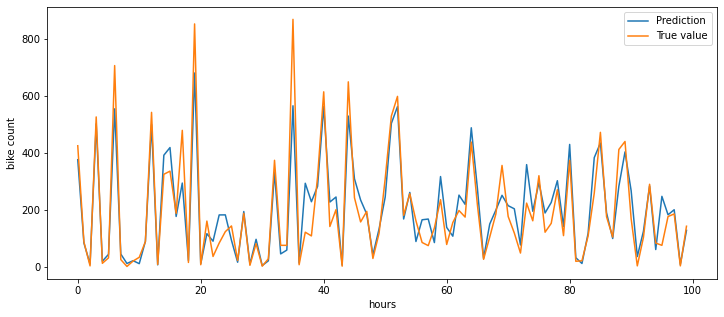

In [93]:
################################## Random Forest regressor
# Features
n_estimators = [int(x) for x in np.linspace(start = 50, stop = 200, num = 10)] # Number of trees in random forest
max_features = ['auto', 'sqrt']                              # Number of features to consider at every split
max_depth = [int(x) for x in np.linspace(10, 20, num = 5)]   # Maximum number of levels in tree
max_depth.append(None)
min_samples_split = [2, 5, 10]                               # Minimum number of samples required to split a node
min_samples_leaf = [1, 2, 4]                                 # Minimum number of samples required at each leaf node
bootstrap = [True, False]                                    # Method of selecting samples for training each tree
# Create the random grid
random_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
               'bootstrap': bootstrap}

# Use the random grid to search for best hyperparameters. First create the base model to tune
rf = RandomForestRegressor()

# Random search of parameters, using 3 fold cross validation, 
#search across 100 different combinations, and use all available cores
rf_random = RandomizedSearchCV(estimator = rf, param_distributions = random_grid, cv = 3, 
                               verbose=2, random_state=42, n_jobs = -1);
# Fit the random search model
rf_random.fit(X_train, y_train)
# Best parameters used in model
best_para = rf_random.best_params_
# Create model
rf_best = RandomForestRegressor(**best_para).fit(X_train, y_train)
# Predict
rf_best.predict(X_test)
# Score of RFR
rf_best.score(X_train, y_train)

# Plot
hrs = 60
y_pred_rf = rf_best.predict(X_test)
fig = plt.subplots(1,figsize=(12,5))
plt.plot(range(hrs),y_test[:hrs],linewidth=2,color = 'green',label='True value')
plt.plot(range(hrs),y_pred_rf[:hrs],linestyle='dashed',label='Test data, RF')
plt.xlabel('hours')
plt.ylabel('bike count')
plt.legend()

# summarize
print('R^2 for Random Forest Regressor: %.3f' % rf_best.score(X_train, y_train))

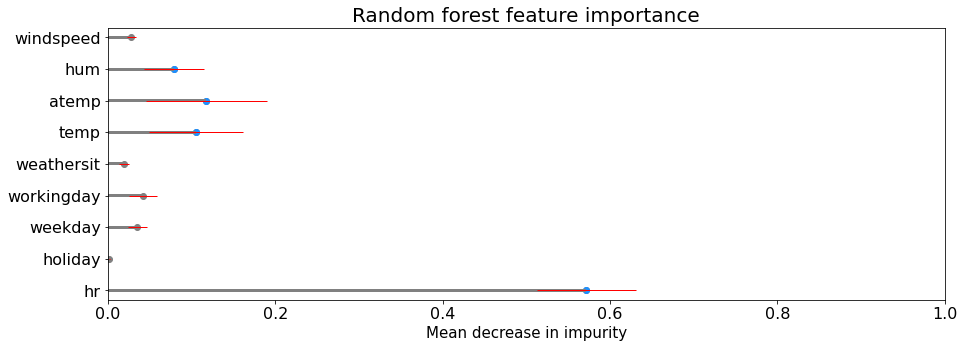

In [15]:
########### Feature importance
# Compute importances 
feature_names = list(X.columns)
importances = rf_best.feature_importances_
std = np.std([tree.feature_importances_ for tree in rf_best.estimators_], axis=0)

# Convert to Pandas Saeries
forest_importances = pd.Series(importances, index=feature_names)
forest_top4 = np.sort(importances)[-4:]
forest_top4_idx = np.argsort(importances)[-4:]

# Plot
fig, ax = plt.subplots(1, figsize=(12,5))
forest_importances.plot.barh(xerr=std, rot=0, fontsize=16, color='grey', width=0.1, error_kw=dict(lw=1, ecolor='red'));
ax.scatter(y = forest_importances.index, x = forest_importances, color='grey', marker='o');
ax.scatter(y = forest_importances[forest_top4_idx].index, x = forest_top4, color='dodgerblue', marker='o');
ax.set_title("Random forest feature importance", fontsize=20);
ax.set_xlabel("Mean decrease in impurity", fontsize=15);
ax.set_xlim([0,1]);

## 4. Genre

We have structured our website around the genre of **Magazine style**. It is a genre that contains a direct path through the narrative with single frame visualizations embeded in a body of text [6]. Moreover, due to the direct path the genre allows the author to gradually educate the reader such that complex information and visualizations can be understood at the end of the paper. This is exactly what we want to accomplish in our website: educate the reader by presenting bike-pattern-insights such that the reader understands how we can build a succesfull machine learning model.<br>
However, we have not only used the *Magazine Style* but also made use of **Annimation** and **Slideshow** genre. The *annimation* genre is expressed in our heatmap movie while the *slideshow* genre is expressed in histogram graphs. The inclusion of these genres creates user-interactivity and add some life to the narrative which we hope can engage the reader even more.

### 4.1 Visual Narrative tools

- **Progress Bar / Timebar** is a tool we have used in the heat movie since it provides the time of each frame. Moreover, we have included the timebar to enable the reader to play the movie back and forth. We hope this will engage the reader and provide deeper insights.
- **Feature Distinction** is a tool we have used in the heat map where we have highlighted neighborhoods with circles. We have done this to make sure the reader is not in doubt about where the neighborhoods are located in the map.
- **Consistent Visual Platform** is a strategy we have used in the histogram graphs to provide an easy transition between the graphs. This will, hopefully, make the reader use less energy to adapt and understand the new graph.

### 4.2 Narrative Structure tools

- **Linear ordering** is used in relation to the aforementioned *magazine style* and is chosen to gradually educate the reader so we can present more complex content in the end of the website. What is meant by complex content is the setup of a machine learning model. 
- **Hover Highlighting / Details** is included in the histogram graphs to enable user interactivity. This will hopefully engage the reader and provide good insights to the bike patterns we present in the histograms.
- **Navigation Buttons** is a tool we have used in the interactive histograms. It provides a compact representation of multiple graphs and enables user interactivity to click through the tabs.

## 5. Visualizations

Explain the visualizations you've chosen.
Why are they right for the story you want to tell?

We have chosen to include different visualizations in our wesbite: *Histograms* and *Heatmaps* <br>
**Histograms:**<br>
This type of visualization is great for communicating *quantitative information* [7]. It is an intuitive graph which are easy to interpret. That is why we have chosen histograms as the first visualization on the website. The first thing we wish to communicate in our story is an insight in bike rental patterns. We investigate the number of rented bikes across weather information and different temporal patterns. To display the quantification of rented bikes across these features, the histogram is convenient due to the aforementioned properties.
<br>
**Heatmaps:**<br>
Heatmap is a great type of visualization to display geo data. In general, maps provide a great overview of areas. Therefore we have included heatmaps to provide this overview of Washington D.C. Furthermore, heatmaps provides additional information to a map in the form of coloring. In our story we are interested in understanding patterns of bike rental so naturally we wish to investigate where in Washington D.C. most bikes are being rented. Moreover, we have created a heatmap movie to show how the bike rental in Washington D.C. develops during a 24 hour cycle. This movie provides a good overview and visual patterns in when and where bikes are rented.

## 6. Discussion

What went well?
What is still missing? What could be improved? Why?

## 7. References

[1] Weather data,UCI Machine Learning Repository. Bike Sharing Dataset Data Set: https://archive.ics.uci.edu/ml/datasets/bike+sharing+dataset visited 03.05.2022 <br>
[2] Bikesharing data, Captial Bikeshare. https://s3.amazonaws.com/capitalbikeshare-data/index.html visted 03.05.2022 <br>
[3] Foggy Bottom neighborhood. https://en.wikipedia.org/wiki/Foggy_Bottom visited 06.05.2022 <br>
[4] Dupont Circle neighborhood.https://en.wikipedia.org/wiki/Dupont_Circle visited 06.05.2022<br>
[5] Washington DC neighborhood map. https://washingtondcmap360.com/washington-dc-neighborhood-map visited 06.05.2022<br>
[6] Edward Segel and Jeffrey. Narrative Visualization: Telling Stories with Data. 2010. http://vis.stanford.edu/files/2010-Narrative-InfoVis.pdf <br>
[7] Philipp Janert. Data Analysis with Open Source Tools Chapter 2.
[8] Yiu Tony. Understanding Random Forest. Jun 12, 2019. https://towardsdatascience.com/understanding-random-forest-58381e0602d2 <br>
[9] Shaw neighborhood. https://en.wikipedia.org/wiki/Shaw_(Washington,_D.C.) visited 10.05.2022

### Contributions